<a href="https://colab.research.google.com/github/AndrzejOlejniczak/Neural-Networks/blob/main/06__transfer_learning_scaling_up.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# EfficentNetB0 vs InceptionV3 feature extraction and fine-tuning in Tensorflow

This is a course exercise of scaling-up that I have worked on a liitle wider that it was originally planned.

Here I:



## Download the data and setup dataset objects

In [ ]:
!nvidia-smi -L

GPU 0: Tesla T4 (UUID: GPU-5d7adc25-36d1-a465-a5b0-084003a9d1b8)


In [ ]:
# Check to see if we're using CPU
!nvidia-smi

Sun Oct 23 17:39:09 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   54C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
# Create helper functions
!wget https://raw.githubusercontent.com/mrdbourke/tensorflow-deep-learning/main/extras/helper_functions.py

--2022-10-23 17:39:09--  https://raw.githubusercontent.com/mrdbourke/tensorflow-deep-learning/main/extras/helper_functions.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 10246 (10K) [text/plain]
Saving to: ‘helper_functions.py’

helper_functions.py 100%[===================>]  10.01K  --.-KB/s    in 0s      

2022-10-23 17:39:09 (102 MB/s) - ‘helper_functions.py’ saved [10246/10246]



In [ ]:
from helper_functions import create_tensorboard_callback, plot_loss_curves, unzip_data, compare_historys, walk_through_dir

In [ ]:
# Download the data
!wget https://storage.googleapis.com/ztm_tf_course/food_vision/101_food_classes_10_percent.zip

--2022-10-23 17:42:49--  https://storage.googleapis.com/ztm_tf_course/food_vision/101_food_classes_10_percent.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 74.125.24.128, 172.217.194.128, 142.251.10.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|74.125.24.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1625420029 (1.5G) [application/zip]
Saving to: ‘101_food_classes_10_percent.zip’

101_food_classes_10 100%[===================>]   1.51G  67.6MB/s    in 23s     

2022-10-23 17:43:13 (67.5 MB/s) - ‘101_food_classes_10_percent.zip’ saved [1625420029/1625420029]



In [ ]:
# Unzip the data
unzip_data('101_food_classes_10_percent.zip')

In [ ]:
# Create data paths
train_dir = '101_food_classes_10_percent/train'
test_dir = '101_food_classes_10_percent/test'

In [ ]:
walk_through_dir('101_food_classes_10_percent')

There are 2 directories and 0 images in '101_food_classes_10_percent'.
There are 101 directories and 0 images in '101_food_classes_10_percent/test'.
There are 0 directories and 250 images in '101_food_classes_10_percent/test/club_sandwich'.
There are 0 directories and 250 images in '101_food_classes_10_percent/test/hot_dog'.
There are 0 directories and 250 images in '101_food_classes_10_percent/test/pork_chop'.
There are 0 directories and 250 images in '101_food_classes_10_percent/test/lobster_roll_sandwich'.
There are 0 directories and 250 images in '101_food_classes_10_percent/test/onion_rings'.
There are 0 directories and 250 images in '101_food_classes_10_percent/test/risotto'.
There are 0 directories and 250 images in '101_food_classes_10_percent/test/strawberry_shortcake'.
There are 0 directories and 250 images in '101_food_classes_10_percent/test/samosa'.
There are 0 directories and 250 images in '101_food_classes_10_percent/test/cheesecake'.
There are 0 directories and 250 imag

In [ ]:
# import the function
from tensorflow.keras.utils import image_dataset_from_directory

# Setup data inputs
train_data_10_percent = image_dataset_from_directory(
    directory=train_dir,
    image_size=(224, 224),
    label_mode='categorical'
)

test_data_10_percent = image_dataset_from_directory(
    directory=test_dir,
    image_size=(224, 224),
    label_mode='categorical',
    shuffle=False 
)

Found 7575 files belonging to 101 classes.
Found 25250 files belonging to 101 classes.


## Some preparations steps

* Create a ModelCheckpoint callback object
* Create data augmentation later

In [ ]:
# Import the relevant class
from tensorflow.keras.callbacks import ModelCheckpoint
# Create a checkpoint callback
checkpoint_path = '101_classes'
checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    save_best_only=True
)

In [ ]:
# Create model checkpoint for second model
checkpoint_path_1  = '101_classes_InceptionV3'
checkpoint_callback_1 = ModelCheckpoint(
    filepath=checkpoint_path_1,
    save_weights_only=True,
    save_best_only=True
)

### Setup data augmentation layer for EfficientNetB0 

In [ ]:
# Import relevant modules
from tensorflow.keras import layers
from tensorflow.keras import Sequential
from tensorflow.keras import Input

# Create data augmentation layer
data_augmentation = Sequential([
    Input(shape=(224, 224, 3)),
    layers.RandomFlip('horizontal'),
    layers.RandomRotation(.2),
    layers.RandomHeight(.2),
    layers.RandomWidth(.2),
    layers.RandomZoom(.2),
    # layers.Rescaling(1./255) Required for models like ResNet50
], name='data_augmentation')

### Setup data augmentation layer for InceptionV3

In [ ]:
# Create data augmentation layer
data_augmentation_1 = Sequential([
    Input(shape=(224, 224, 3)),
    layers.RandomFlip('horizontal'),
    layers.RandomRotation(.2),
    layers.RandomHeight(.2),
    layers.RandomWidth(.2),
    layers.RandomZoom(.2)
], name='data_augmentation_1')

## Download and setup 2 models for feature extraction

* Build a base_model with no top layers for classification based on EfficientNetB0

In [ ]:
import tensorflow as tf

### Download and setup EfficientNetB0

In [ ]:
# Setup the base model
base_model = tf.keras.applications.EfficientNetB0(include_top=False)

16705208/16705208 [==============================] - 0s 0us/step


In [ ]:
base_model.summary()

Model: "efficientnetb0"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 rescaling (Rescaling)          (None, None, None,   0           ['input_3[0][0]']                
                                3)                                                                
                                                                                                  
 normalization (Normalization)  (None, None, None,   7           ['rescaling[0][0]']              
                                3)                                                   

In [ ]:
# Freeze the layers
base_model.trainable = False

In [ ]:
len(base_model.trainable_variables)

0

In [ ]:
# Create model with trainable top layers
inputs = Input(shape=(224, 224, 3), name='input layer')
x = data_augmentation(inputs)
x = base_model(x, training = False)
x = layers.GlobalAveragePooling2D(name='global_avf_pool1d_lay')(x)
outputs = layers.Dense(len(train_data_10_percent.class_names), activation='softmax', name='output_layer')(x)
model_0 = tf.keras.Model(inputs, outputs)

In [ ]:
model_0.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input layer (InputLayer)    [(None, 224, 224, 3)]     0         
                                                                 
 data_augmentation (Sequenti  (None, None, None, 3)    0         
 al)                                                             
                                                                 
 efficientnetb0 (Functional)  (None, None, None, 1280)  4049571  
                                                                 
 global_avf_pool1d_lay (Glob  (None, 1280)             0         
 alAveragePooling2D)                                             
                                                                 
 output_layer (Dense)        (None, 101)               129381    
                                                                 
Total params: 4,178,952
Trainable params: 129,381
Non-trainab

In [ ]:
# Compile the model
model_0.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
                optimizer=tf.keras.optimizers.Adam(),
                metrics='accuracy')

In [ ]:
# Fit the model
history_0_0 = model_0.fit(train_data_10_percent,
                          validation_data=test_data_10_percent,
                          epochs=5,
                          steps_per_epoch=len(train_data_10_percent),
                          validation_steps=int(.25*len(test_data_10_percent)),
                          callbacks=[checkpoint_callback])

Epoch 1/5
237/237 [==============================] - 109s 400ms/step - loss: 3.3983 - accuracy: 0.2710 - val_loss: 2.4669 - val_accuracy: 0.4548
Epoch 2/5
237/237 [==============================] - 76s 318ms/step - loss: 2.2050 - accuracy: 0.4950 - val_loss: 2.0079 - val_accuracy: 0.5146
Epoch 3/5
237/237 [==============================] - 67s 278ms/step - loss: 1.8266 - accuracy: 0.5698 - val_loss: 1.8578 - val_accuracy: 0.5284
Epoch 4/5
237/237 [==============================] - 63s 264ms/step - loss: 1.6121 - accuracy: 0.6069 - val_loss: 1.7721 - val_accuracy: 0.5417
Epoch 5/5
237/237 [==============================] - 58s 244ms/step - loss: 1.4493 - accuracy: 0.6459 - val_loss: 1.7197 - val_accuracy: 0.5530


### Download InceptionV3

In [ ]:
# Setup the base model
base_model_1 = tf.keras.applications.InceptionV3(include_top=False)

87910968/87910968 [==============================] - 1s 0us/step


In [ ]:
base_model_1.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   864         ['input_4[0][0]']                
                                32)                                                               
                                                                                                  
 batch_normalization (BatchNorm  (None, None, None,   96         ['conv2d[0][0]']                 
 alization)                     32)                                                    

In [ ]:
# Freeze the model
base_model_1.trainable = False

In [ ]:
len(base_model_1.trainable_variables)

0

In [ ]:
help(tf.keras.applications.inception_v3.preprocess_input)

Help on function preprocess_input in module keras.applications.inception_v3:

preprocess_input(x, data_format=None)
    Preprocesses a tensor or Numpy array encoding a batch of images.
    
    Usage example with `applications.MobileNet`:
    
    ```python
    i = tf.keras.layers.Input([None, None, 3], dtype = tf.uint8)
    x = tf.cast(i, tf.float32)
    x = tf.keras.applications.mobilenet.preprocess_input(x)
    core = tf.keras.applications.MobileNet()
    x = core(x)
    model = tf.keras.Model(inputs=[i], outputs=[x])
    
    image = tf.image.decode_png(tf.io.read_file('file.png'))
    result = model(image)
    ```
    
    Args:
      x: A floating point `numpy.array` or a `tf.Tensor`, 3D or 4D with 3 color
        channels, with values in the range [0, 255].
        The preprocessed data are written over the input data
        if the data types are compatible. To avoid this
        behaviour, `numpy.copy(x)` can be used.
      data_format: Optional data format of the image tensor

In [ ]:
# Create model with trainable top layers
inputs_1 = Input(shape=(224, 224, 3), name='input_layer_1')
y = data_augmentation(inputs_1)
y = tf.cast(y, tf.float32)
y = tf.keras.applications.inception_v3.preprocess_input(y)
y = base_model_1(y, training = False)
y = layers.GlobalAveragePooling2D(name='global_avf_pool1d_lay_1')(y)
outputs_1 = layers.Dense(len(train_data_10_percent.class_names), kernel_regularizer=tf.keras.regularizers.l2(.0005), activation='softmax', name='output_layer_1')(y)
model_1 = tf.keras.Model(inputs_1, outputs_1)

In [ ]:
model_1.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer_1 (InputLayer)  [(None, 224, 224, 3)]     0         
                                                                 
 data_augmentation (Sequenti  (None, None, None, 3)    0         
 al)                                                             
                                                                 
 tf.cast (TFOpLambda)        (None, 224, 224, 3)       0         
                                                                 
 tf.math.truediv_1 (TFOpLamb  (None, 224, 224, 3)      0         
 da)                                                             
                                                                 
 tf.math.subtract (TFOpLambd  (None, 224, 224, 3)      0         
 a)                                                              
                                                           

In [ ]:
# Compile second model
model_1.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
                optimizer=tf.keras.optimizers.Adam(),
                metrics=['accuracy'])

In [ ]:
# Fit the second model
history_1_0 = model_1.fit(train_data_10_percent,
                          validation_data=test_data_10_percent,
                          epochs=5,
                          steps_per_epoch=len(train_data_10_percent),
                          validation_steps=int(.25*len(test_data_10_percent)),
                          callbacks=[checkpoint_callback_1])

Epoch 1/5
237/237 [==============================] - 163s 666ms/step - loss: 3.9487 - accuracy: 0.1843 - val_loss: 3.3128 - val_accuracy: 0.2546
Epoch 2/5
237/237 [==============================] - 107s 451ms/step - loss: 2.9780 - accuracy: 0.3299 - val_loss: 2.9103 - val_accuracy: 0.3193
Epoch 3/5
237/237 [==============================] - 90s 380ms/step - loss: 2.6654 - accuracy: 0.3905 - val_loss: 2.8743 - val_accuracy: 0.3414
Epoch 4/5
237/237 [==============================] - 81s 339ms/step - loss: 2.5720 - accuracy: 0.4095 - val_loss: 2.7735 - val_accuracy: 0.3675
Epoch 5/5
237/237 [==============================] - 80s 338ms/step - loss: 2.4537 - accuracy: 0.4387 - val_loss: 3.0277 - val_accuracy: 0.3212


In [ ]:
model_0.evaluate(test_data_10_percent), model_1.evaluate(test_data_10_percent)

790/790 [==============================] - 66s 84ms/step - loss: 2.5745 - accuracy: 0.4075


([1.5707088708877563, 0.5904950499534607],
 [2.5745198726654053, 0.40748515725135803])

### Compare histories after training both models for 5 epochs

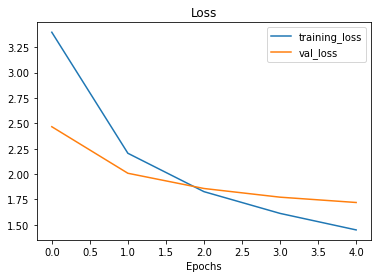

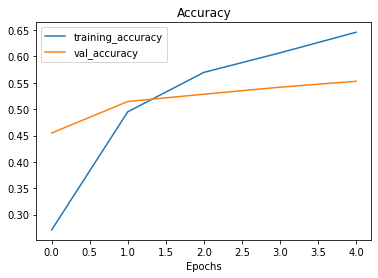

In [ ]:
plot_loss_curves(history_0_0)

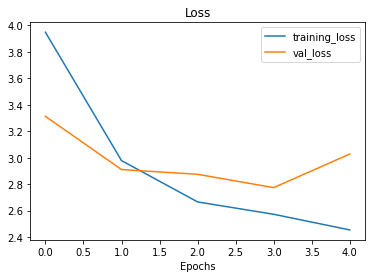

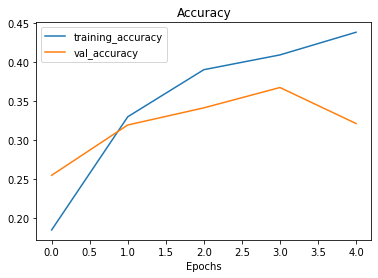

In [ ]:
plot_loss_curves(history_1_0)

**Both models show signs of overfitting**

## Fine-tuning of the EfficientNetB0-based model

### Unfreeze 5 layers in the base_model

In [ ]:
# unfreeze all of the layers in base_model
base_model.trainable = True

# Refreeze every layer except the last 5
for layer in base_model.layers[:-5]:
  layer.trainable = False

In [ ]:
# Recompile the model with reduced learning rate
model_0.compile(
    loss=tf.keras.losses.CategoricalCrossentropy(),
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
    metrics=['accuracy']
)

In [ ]:
for layer in model_0.layers:
  print(layer.name, layer.trainable)

input layer True
data_augmentation True
efficientnetb0 True
global_avf_pool1d_lay True
output_layer True


In [ ]:
# Check which layers are trainable in base_model
for layer_number, layer in enumerate(model_0.layers[2].layers):
  print(layer_number, layer.name, layer.trainable, layer.trainable_variables)

0 input_3 False []
1 rescaling False []
2 normalization False []
3 tf.math.truediv False []
4 stem_conv_pad False []
5 stem_conv False []
6 stem_bn False []
7 stem_activation False []
8 block1a_dwconv False []
9 block1a_bn False []
10 block1a_activation False []
11 block1a_se_squeeze False []
12 block1a_se_reshape False []
13 block1a_se_reduce False []
14 block1a_se_expand False []
15 block1a_se_excite False []
16 block1a_project_conv False []
17 block1a_project_bn False []
18 block2a_expand_conv False []
19 block2a_expand_bn False []
20 block2a_expand_activation False []
21 block2a_dwconv_pad False []
22 block2a_dwconv False []
23 block2a_bn False []
24 block2a_activation False []
25 block2a_se_squeeze False []
26 block2a_se_reshape False []
27 block2a_se_reduce False []
28 block2a_se_expand False []
29 block2a_se_excite False []
30 block2a_project_conv False []
31 block2a_project_bn False []
32 block2b_expand_conv False []
33 block2b_expand_bn False []
34 block2b_expand_activation Fa

In [ ]:
!pip install math

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
ERROR: Could not find a version that satisfies the requirement math (from versions: none)
ERROR: No matching distribution found for math


In [ ]:
# Since Google Colab uses python 3.6 as kernel and math.prod is unavailable ...
from functools import reduce
import operator

In [ ]:
# How many trainable parameters did we unfreeze on the top of EfficientNetB0?
n = 0
for element in base_model.trainable_variables:
  print(element.shape)
  n += reduce(operator.mul, element.shape, 1)

n

(1, 1, 1152, 320)
(320,)
(320,)
(1, 1, 320, 1280)
(1280,)
(1280,)


781440

In [ ]:
# Fine-tune for 5 more epochs
fine_tune_epochs_0 = 10

# Fine-tune model_0
history_0_1 = model_0.fit(
    train_data_10_percent,
    epochs=fine_tune_epochs_0,
    validation_data=test_data_10_percent,
    validation_steps=int(.15*len(test_data_10_percent)),
    initial_epoch=history_0_0.epoch[-1]
)

Epoch 5/10
237/237 [==============================] - 66s 246ms/step - loss: 1.1889 - accuracy: 0.6865 - val_loss: 1.7356 - val_accuracy: 0.5495
Epoch 6/10
237/237 [==============================] - 50s 209ms/step - loss: 1.0945 - accuracy: 0.7044 - val_loss: 1.7007 - val_accuracy: 0.5561
Epoch 7/10
237/237 [==============================] - 47s 197ms/step - loss: 1.0128 - accuracy: 0.7291 - val_loss: 1.6959 - val_accuracy: 0.5609
Epoch 8/10
237/237 [==============================] - 45s 189ms/step - loss: 0.9368 - accuracy: 0.7481 - val_loss: 1.7277 - val_accuracy: 0.5482
Epoch 9/10
237/237 [==============================] - 44s 184ms/step - loss: 0.8763 - accuracy: 0.7653 - val_loss: 1.7522 - val_accuracy: 0.5432
Epoch 10/10
237/237 [==============================] - 43s 179ms/step - loss: 0.8208 - accuracy: 0.7787 - val_loss: 1.7249 - val_accuracy: 0.5527


In [ ]:
# Evaluate on the whole test_data
model_0.evaluate(test_data_10_percent)

790/790 [==============================] - 69s 88ms/step - loss: 1.4896 - accuracy: 0.6058


[1.4895635843276978, 0.6058217883110046]

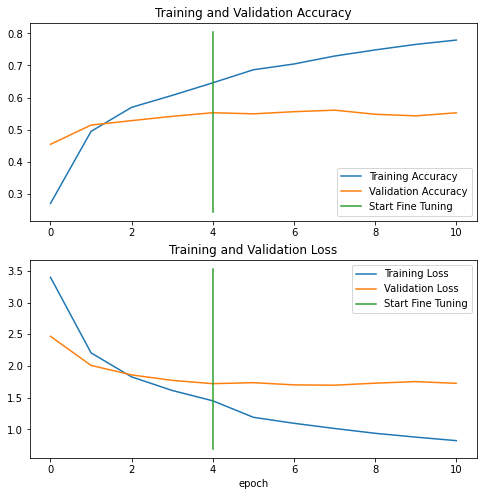

In [ ]:
# Compate the histories of feature-extraction model with 1. fine-tuning model
compare_historys(history_0_0, history_0_1)

## Fine-tuning InceptionV3 model

In [ ]:
# Unfreeze base_model_1
base_model_1.trainable = True

In [ ]:
base_model_1.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   864         ['input_4[0][0]']                
                                32)                                                               
                                                                                                  
 batch_normalization (BatchNorm  (None, None, None,   96         ['conv2d[0][0]']                 
 alization)                     32)                                                    

**I would like to treat both base models equally. Unfortunatelly top two convolutional layers (so layers that register information about the picture) in EfficientNetB0 are within 5 top layers. The architectire of InceptionV3 is quite different. One have to unfreeze at least 17 top layers to have at least 2 convolutional layers unfrozen.**

In [ ]:
# Refreeze base_model_1
for layer in base_model_1.layers[:-17]:
  layer.trainable=False

In [ ]:
# Recompile the model with reduced learning rate
model_1.compile(
    loss=tf.keras.losses.CategoricalCrossentropy(),
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
    metrics=['accuracy']
)

In [ ]:
len(base_model_1.trainable_variables)

8

In [ ]:
n = 0
for element in base_model_1.trainable_variables:
  print(element.shape)
  n += reduce(operator.mul, element.shape, 1)

n

(1, 1, 2048, 320)
(384,)
(384,)
(384,)
(384,)
(1, 1, 2048, 192)
(320,)
(192,)


1050624

In [ ]:
# Fine-tune for 5 more epochs
fine_tune_epochs_1 = 10

# Fine-tune model_0
history_1_1 = model_1.fit(
    train_data_10_percent,
    epochs=fine_tune_epochs_1,
    validation_data=test_data_10_percent,
    validation_steps=int(.15*len(test_data_10_percent)),
    initial_epoch=history_0_0.epoch[-1]
)

Epoch 5/10
237/237 [==============================] - 78s 305ms/step - loss: 2.0245 - accuracy: 0.5229 - val_loss: 2.6168 - val_accuracy: 0.3975
Epoch 6/10
237/237 [==============================] - 61s 257ms/step - loss: 1.8577 - accuracy: 0.5575 - val_loss: 2.5358 - val_accuracy: 0.4126
Epoch 7/10
237/237 [==============================] - 61s 254ms/step - loss: 1.7506 - accuracy: 0.5851 - val_loss: 2.5993 - val_accuracy: 0.4039
Epoch 8/10
237/237 [==============================] - 53s 223ms/step - loss: 1.6877 - accuracy: 0.6050 - val_loss: 2.6273 - val_accuracy: 0.3996
Epoch 9/10
237/237 [==============================] - 59s 248ms/step - loss: 1.5942 - accuracy: 0.6156 - val_loss: 2.5172 - val_accuracy: 0.4237
Epoch 10/10
237/237 [==============================] - 54s 225ms/step - loss: 1.5239 - accuracy: 0.6300 - val_loss: 2.4677 - val_accuracy: 0.4343


In [ ]:
# Evaluate the model on all the validation data
model_1.evaluate(test_data_10_percent)

790/790 [==============================] - 64s 81ms/step - loss: 2.1683 - accuracy: 0.4937


[2.1682815551757812, 0.4937029778957367]

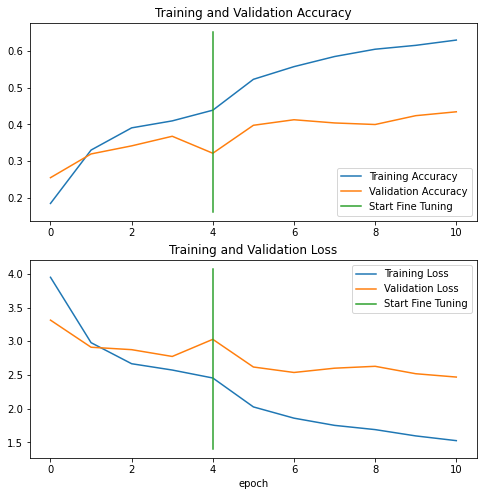

In [ ]:
compare_historys(history_1_0, history_1_1)

**Both models are overfitting fast. To challange this problem let's look into literature:**

https://arxiv.org/abs/2111.04578 


In [ ]:
# Saving and loading the model for future use
model_0.save('drive/MyDrive/Colab Notebooks/06_tansfer_learning_scaling_up_FILES/model_0.h5')

In [ ]:
model_1.save('drive/MyDrive/Colab Notebooks/06_tansfer_learning_scaling_up_FILES/model_1.h5')

In [ ]:
# Load and evaluate saved model
model_0_loaded = tf.keras.models.load_model('drive/MyDrive/Colab Notebooks/06_tansfer_learning_scaling_up_FILES/model_0.h5')

In [ ]:
model_0_loaded.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input layer (InputLayer)    [(None, 224, 224, 3)]     0         
                                                                 
 data_augmentation (Sequenti  (None, 224, 224, 3)      0         
 al)                                                             
                                                                 
 efficientnetb0 (Functional)  (None, None, None, 1280)  4049571  
                                                                 
 global_avf_pool1d_lay (Glob  (None, 1280)             0         
 alAveragePooling2D)                                             
                                                                 
 output_layer (Dense)        (None, 101)               129381    
                                                                 
Total params: 4,178,952
Trainable params: 910,821
Non-trainab

In [ ]:
# Evaluate loaded EfficeintNetB0 model
model_0_loaded.evaluate(test_data_10_percent)

790/790 [==============================] - 61s 76ms/step - loss: 1.4896 - accuracy: 0.6058


[1.4895635843276978, 0.6058217883110046]

## Evaluate models and find out which food class generates most confusion.

### Find Accuracy per food class for EfficientNetB0

In [ ]:
# Get model's predictions
preds_probs = model_0_loaded.predict(test_data_10_percent, verbose=1)

790/790 [==============================] - 63s 78ms/step


In [ ]:
import numpy as np
import pandas as pd

In [ ]:
# Get class names
class_names = np.array(test_data_10_percent.class_names)

In [ ]:
# Unbatch test data 
test_data_unbatched = test_data_10_percent.unbatch()

In [ ]:
# Create a list of true labels
labels = np.array(list(test_data_unbatched.map(lambda x, y: y)))

In [ ]:
# Inspect the data
labels.shape, preds_probs.shape, class_names.shape

((25250, 101), (25250, 101), (101,))

In [ ]:
# Create a DataFrame 
model_0_predictions_df = pd.DataFrame(preds_probs, columns=class_names.tolist())

In [ ]:
# Create predicted values (label) column, checking the argmax in 101-item-long array of predictions
predicted_values = [np.argmax(model_0_predictions_df.iloc[x, :101]) for x in model_0_predictions_df.index]
model_0_predictions_df['predicted_values'] = predicted_values

In [ ]:
# Using class_names list add column with predicted class names
predicted_names = [class_names.tolist()[np.argmax(model_0_predictions_df.iloc[x, :101])] for x in model_0_predictions_df.index]
model_0_predictions_df['predicted_names'] = predicted_names

In [ ]:
# Create true labels column 
true_labels = [np.argmax(labels[x, :101]) for x in range(labels.shape[0])]
model_0_predictions_df['labels'] = true_labels

In [ ]:
# Add a column with true class names
model_0_predictions_df['labels_names'] = [class_names.tolist()[np.argmax(labels[x, :101])] for x in model_0_predictions_df.index]

In [ ]:
# Add a column recording if the prediction was a success
model_0_predictions_df['success'] = model_0_predictions_df.predicted_values == model_0_predictions_df.labels 

In [ ]:
sum(model_0_predictions_df.success) / len(model_0_predictions_df)

0.6058217821782178

In [ ]:
model_0_predictions_df

,apple_pie,baby_back_ribs,baklava,beef_carpaccio,beef_tartare,beet_salad,beignets,bibimbap,bread_pudding,breakfast_burrito,...,tacos,takoyaki,tiramisu,tuna_tartare,waffles,predicted_values,predicted_names,labels,labels_names,success
0,0.439913,4.077382e-04,8.427838e-02,9.245325e-08,2.525972e-06,2.578216e-06,1.022579e-04,3.129833e-06,0.005987,2.481569e-04,...,4.215084e-04,1.662912e-04,6.985989e-06,2.885244e-03,0.008293,0,apple_pie,0,apple_pie,True
1,0.910876,1.138382e-07,6.866059e-04,7.661098e-07,6.791954e-07,2.106860e-07,1.497418e-05,2.242515e-07,0.000096,1.074590e-06,...,4.195982e-07,3.763831e-07,2.910129e-03,7.897536e-07,0.000003,0,apple_pie,0,apple_pie,True
2,0.679421,1.223379e-02,9.325815e-03,3.724109e-06,2.206978e-05,9.545900e-04,4.465714e-04,4.552702e-04,0.063700,3.127186e-04,...,1.751371e-04,1.310721e-02,1.968933e-04,2.038088e-04,0.001966,0,apple_pie,0,apple_pie,True
3,0.175916,8.959266e-04,1.623148e-03,3.771173e-07,1.589378e-04,1.468885e-04,8.196448e-04,1.498543e-05,0.208317,2.436948e-02,...,1.150743e-04,2.341407e-03,6.626725e-04,2.882995e-04,0.005376,38,fish_and_chips,0,apple_pie,False
4,0.209832,1.901099e-06,3.123116e-02,7.144481e-09,1.440461e-06,2.479346e-06,8.714313e-05,1.651680e-06,0.596362,1.706573e-03,...,2.890373e-05,4.232237e-06,5.189658e-05,5.929362e-04,0.000029,8,bread_pudding,0,apple_pie,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25245,0.007537,1.316837e-04,3.561103e-06,1.605978e-07,3.321732e-06,1.230189e-06,8.238475e-08,3.050430e-07,0.000002,3.193592e-06,...,3.138675e-06,3.503242e-06,4.592130e-07,6.820176e-07,0.976706,100,waffles,100,waffles,True
25246,0.000020,2.411342e-06,1.962506e-06,1.332831e-09,3.232509e-07,1.785765e-06,1.138269e-08,4.093343e-10,0.000003,2.522610e-10,...,6.950989e-10,1.077572e-09,2.476207e-06,3.021243e-06,0.364426,16,cheese_plate,100,waffles,False
25247,0.000330,5.030761e-02,5.060256e-07,9.249037e-04,1.140880e-04,1.403047e-03,1.347038e-04,1.566340e-06,0.015621,6.675390e-03,...,9.542309e-05,1.026885e-02,1.312573e-03,7.398269e-04,0.455976,100,waffles,100,waffles,True
25248,0.009432,1.094697e-02,6.809690e-03,1.416270e-06,2.915763e-03,3.520309e-05,1.184583e-05,3.938555e-06,0.132049,4.074016e-04,...,3.197052e-06,1.192203e-04,3.094572e-04,3.690922e-04,0.135892,94,strawberry_shortcake,100,waffles,False


In [ ]:
# Create a DataFrame with accuracy ranking per food class for EfficientNetB0 transfer learning model
ENB0_ranking_0 = pd.DataFrame(index=[class_names.tolist()], columns=['model_0_accuracy'])
for class_name in class_names.tolist():
  ENB0_ranking_0.loc[class_name,'model_0_accuracy'] = sum(model_0_predictions_df.success[model_0_predictions_df.labels_names == class_name]) / len(model_0_predictions_df[model_0_predictions_df.labels_names == class_name])

#### Create a confusion ranking

In [ ]:
 # Create and check , which food classes are most confusing for the EfficientNetB0 model 0.
 model_0_class_name_ranking = ENB0_ranking_0.model_0_accuracy.sort_values()

In [ ]:
def print_full(x):
    pd.set_option('display.max_rows', len(x))
    print(x)
    pd.reset_option('display.max_rows')

In [ ]:
print_full(model_0_class_name_ranking)

foie_gras                  0.224
nachos                      0.26
pork_chop                  0.268
apple_pie                  0.272
ceviche                    0.324
tacos                      0.336
ravioli                    0.352
falafel                    0.352
steak                      0.356
grilled_salmon             0.356
strawberry_shortcake       0.372
lasagna                    0.372
paella                     0.384
scallops                   0.392
beet_salad                 0.392
tuna_tartare               0.396
fried_rice                 0.408
bruschetta                 0.412
crab_cakes                 0.428
beef_tartare                0.44
huevos_rancheros           0.456
chocolate_mousse           0.468
grilled_cheese_sandwich    0.468
peking_duck                0.472
chicken_curry              0.492
hummus                       0.5
cheesecake                   0.5
gnocchi                    0.504
risotto                    0.504
beef_carpaccio             0.508
french_toa

#### Check which food classes are confused with each other most?

In [ ]:
# Subset unsuccessful predictions
model_0_predictions_df_failed = model_0_predictions_df[model_0_predictions_df['success'] == False]

In [ ]:
# Groupby unsuccessful predictions by label name and predicted label name
model_0_predictions_df_failed_GB = model_0_predictions_df_failed.groupby(['labels_names', 'predicted_names'])

In [ ]:
pd.__version__

'1.3.5'

In [ ]:
model_0_predictions_confusion_ranking = model_0_predictions_df_failed_GB['success'].count().to_frame().rename(axis=1, mapper={'success':'n_confused'})

In [ ]:
model_0_predictions_confusion_ranking['n_confused'].sort_values(ascending=False).head(40)

labels_names          predicted_names        
steak                 filet_mignon               58
pork_chop             filet_mignon               53
apple_pie             bread_pudding              52
spaghetti_bolognese   spaghetti_carbonara        46
fried_rice            risotto                    43
strawberry_shortcake  bread_pudding              37
falafel               crab_cakes                 37
beef_tartare          tuna_tartare               37
strawberry_shortcake  cheesecake                 37
filet_mignon          steak                      37
foie_gras             filet_mignon               34
chicken_quesadilla    breakfast_burrito          34
nachos                huevos_rancheros           32
hamburger             pulled_pork_sandwich       32
club_sandwich         grilled_cheese_sandwich    31
panna_cotta           chocolate_mousse           31
frozen_yogurt         ice_cream                  31
steak                 baby_back_ribs             31
carrot_cake       

**Is it possible to balance unbalance cross-class accuracy by applying "imbalanced" dataset at preprocessing stage?**

#### Create confusion matrx

In [ ]:
class_names

array(['apple_pie', 'baby_back_ribs', 'baklava', 'beef_carpaccio',
       'beef_tartare', 'beet_salad', 'beignets', 'bibimbap',
       'bread_pudding', 'breakfast_burrito', 'bruschetta', 'caesar_salad',
       'cannoli', 'caprese_salad', 'carrot_cake', 'ceviche',
       'cheese_plate', 'cheesecake', 'chicken_curry',
       'chicken_quesadilla', 'chicken_wings', 'chocolate_cake',
       'chocolate_mousse', 'churros', 'clam_chowder', 'club_sandwich',
       'crab_cakes', 'creme_brulee', 'croque_madame', 'cup_cakes',
       'deviled_eggs', 'donuts', 'dumplings', 'edamame', 'eggs_benedict',
       'escargots', 'falafel', 'filet_mignon', 'fish_and_chips',
       'foie_gras', 'french_fries', 'french_onion_soup', 'french_toast',
       'fried_calamari', 'fried_rice', 'frozen_yogurt', 'garlic_bread',
       'gnocchi', 'greek_salad', 'grilled_cheese_sandwich',
       'grilled_salmon', 'guacamole', 'gyoza', 'hamburger',
       'hot_and_sour_soup', 'hot_dog', 'huevos_rancheros', 'hummus',
       

In [ ]:
# Create make cofusion matrix function
import itertools
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

def make_confusion_matrix(y_true, y_pred, classes=None, figsize=(10, 10), text_size=15, norm=False, savefig=False): 
  """Makes a labelled confusion matrix comparing predictions and ground truth labels.

  If classes is passed, confusion matrix will be labelled, if not, integer class values
  will be used.

  Args:
    y_true: Array of truth labels (must be same shape as y_pred).
    y_pred: Array of predicted labels (must be same shape as y_true).
    classes: Array of class labels (e.g. string form). If `None`, integer labels are used.
    figsize: Size of output figure (default=(10, 10)).
    text_size: Size of output figure text (default=15).
    norm: normalize values or not (default=False).
    savefig: save confusion matrix to file (default=False).
  
  Returns:
    A labelled confusion matrix plot comparing y_true and y_pred.

  Example usage:
    make_confusion_matrix(y_true=test_labels, # ground truth test labels
                          y_pred=y_preds, # predicted labels
                          classes=class_names, # array of class label names
                          figsize=(15, 15),
                          text_size=10)
  """  
  # Create the confustion matrix
  cm = confusion_matrix(y_true, y_pred)
  cm_norm = cm.astype("float") / cm.sum(axis=1)[:, np.newaxis] # normalize it
  n_classes = cm.shape[0] # find the number of classes we're dealing with

  # Plot the figure and make it pretty
  fig, ax = plt.subplots(figsize=figsize)
  cax = ax.matshow(cm, cmap=plt.cm.Blues) # colors will represent how 'correct' a class is, darker == better
  fig.colorbar(cax)

  # Are there a list of classes?
  if classes:
    labels = classes
  else:
    labels = np.arange(cm.shape[0])
  
  # Label the axes
  ax.set(title="Confusion Matrix",
         xlabel="Predicted label",
         ylabel="True label",
         xticks=np.arange(n_classes), # create enough axis slots for each class
         yticks=np.arange(n_classes), 
         xticklabels=labels, # axes will labeled with class names (if they exist) or ints
         yticklabels=labels)
  
  # Make x-axis labels appear on bottom
  ax.xaxis.set_label_position("bottom")
  ax.xaxis.tick_bottom()

  # Set xticks yticks additional parameters

  plt.xticks(rotation = 450, fontsize=text_size)
  plt.yticks(fontsize=text_size)

  # Set the threshold for different colors
  threshold = (cm.max() + cm.min()) / 2.

  # Plot the text on each cell
  for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
    if norm:
      plt.text(j, i, f"{cm[i, j]} ({cm_norm[i, j]*100:.1f}%)",
              horizontalalignment="center",
              color="white" if cm[i, j] > threshold else "black",
              size=text_size)
    else:
      plt.text(j, i, f"{cm[i, j]}",
              horizontalalignment="center",
              color="white" if cm[i, j] > threshold else "black",
              size=text_size)

  # Save the figure to the current working directory
  if savefig:
    fig.savefig("confusion_matrix.png")


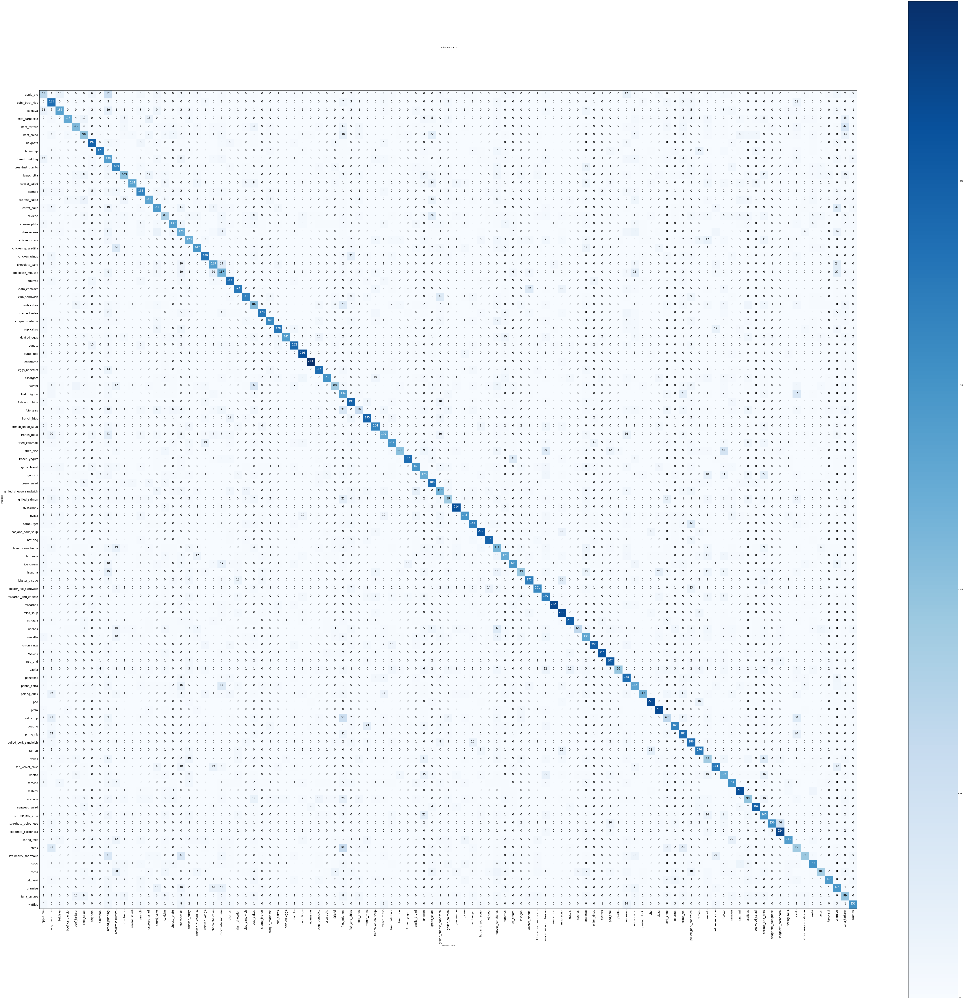

In [ ]:
make_confusion_matrix(y_true=model_0_predictions_df['labels'] , y_pred=model_0_predictions_df['predicted_values'] , classes=test_data_10_percent.class_names, figsize=(100, 100))

#### Create a classcification report

In [ ]:
# Import sklearn module
from sklearn.metrics import classification_report

In [ ]:
print(classification_report(y_true=model_0_predictions_df['labels'], y_pred=model_0_predictions_df['predicted_values']))

              precision    recall  f1-score   support

           0       0.33      0.27      0.30       250
           1       0.50      0.74      0.60       250
           2       0.67      0.54      0.60       250
           3       0.88      0.51      0.64       250
           4       0.55      0.44      0.49       250
           5       0.49      0.39      0.43       250
           6       0.74      0.79      0.76       250
           7       0.89      0.71      0.79       250
           8       0.25      0.56      0.35       250
           9       0.43      0.65      0.52       250
          10       0.58      0.41      0.48       250
          11       0.88      0.54      0.67       250
          12       0.64      0.66      0.65       250
          13       0.63      0.53      0.58       250
          14       0.49      0.58      0.53       250
          15       0.42      0.32      0.37       250
          16       0.66      0.56      0.60       250
          17       0.37    

**Lets plot f1-score across the classes**

In [ ]:
# Create classcification report dictionary
classification_report_dict = classification_report(
    y_true=model_0_predictions_df['labels'],
    y_pred=model_0_predictions_df['predicted_values'],
    output_dict=True,
)

In [ ]:
classification_report_df = pd.DataFrame(classification_report_dict).transpose()

In [ ]:
test_data_10_percent.class_names

['apple_pie',
 'baby_back_ribs',
 'baklava',
 'beef_carpaccio',
 'beef_tartare',
 'beet_salad',
 'beignets',
 'bibimbap',
 'bread_pudding',
 'breakfast_burrito',
 'bruschetta',
 'caesar_salad',
 'cannoli',
 'caprese_salad',
 'carrot_cake',
 'ceviche',
 'cheese_plate',
 'cheesecake',
 'chicken_curry',
 'chicken_quesadilla',
 'chicken_wings',
 'chocolate_cake',
 'chocolate_mousse',
 'churros',
 'clam_chowder',
 'club_sandwich',
 'crab_cakes',
 'creme_brulee',
 'croque_madame',
 'cup_cakes',
 'deviled_eggs',
 'donuts',
 'dumplings',
 'edamame',
 'eggs_benedict',
 'escargots',
 'falafel',
 'filet_mignon',
 'fish_and_chips',
 'foie_gras',
 'french_fries',
 'french_onion_soup',
 'french_toast',
 'fried_calamari',
 'fried_rice',
 'frozen_yogurt',
 'garlic_bread',
 'gnocchi',
 'greek_salad',
 'grilled_cheese_sandwich',
 'grilled_salmon',
 'guacamole',
 'gyoza',
 'hamburger',
 'hot_and_sour_soup',
 'hot_dog',
 'huevos_rancheros',
 'hummus',
 'ice_cream',
 'lasagna',
 'lobster_bisque',
 'lobster

In [ ]:
class_names_copy = test_data_10_percent.class_names + [0, 0, 0]
len(class_names_copy)

104

In [ ]:
classification_report_df['class_names'] = class_names_copy

In [ ]:
classification_report_df_sorted = classification_report_df.sort_values('f1-score', ascending=False)
classification_report_df_sorted

,precision,recall,f1-score,support,class_names
33,0.960630,0.976,0.968254,250.0,edamame
63,0.948718,0.888,0.917355,250.0,macarons
69,0.886555,0.844,0.864754,250.0,oysters
75,0.827068,0.880,0.852713,250.0,pho
51,0.819923,0.856,0.837573,250.0,guacamole
...,...,...,...,...,...
93,0.301695,0.356,0.326606,250.0,steak
82,0.296296,0.352,0.321755,250.0,ravioli
39,0.523364,0.224,0.313725,250.0,foie_gras
77,0.343590,0.268,0.301124,250.0,pork_chop


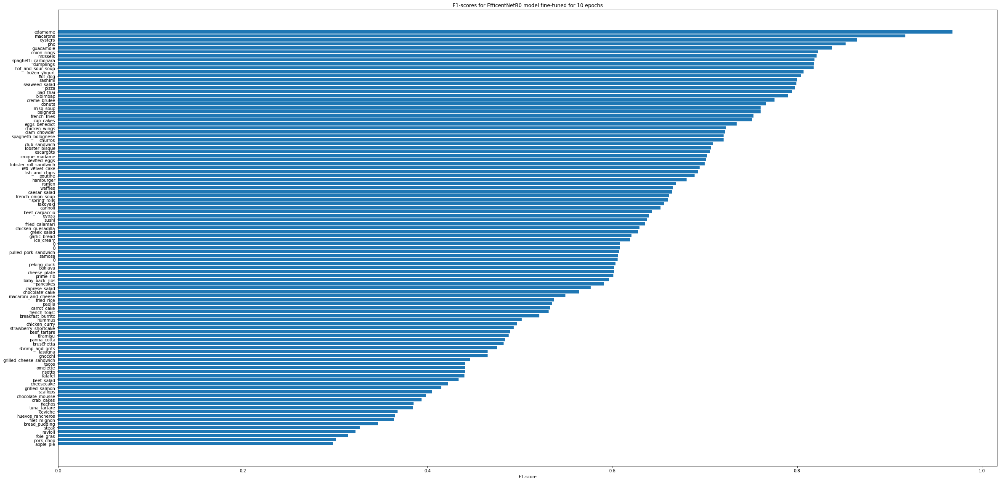

In [ ]:
# Create bar plot
fig, ax = plt.subplots(figsize=(40, 20))
ax.barh(y=classification_report_df_sorted.index, tick_label=classification_report_df_sorted['class_names'], width=classification_report_df_sorted['f1-score'])
ax.set_xlabel('F1-score')
ax.set_title('F1-scores for EfficentNetB0 model fine-tuned for 10 epochs')
ax.invert_yaxis()
plt.show()

### Find Accuracy per food class for Inception V3

#### Create a confusion ranking plotting classification report
Using an Udemy Course method...

In [ ]:
# Load, summarize and evaluate model
model_1_loaded = tf.keras.models.load_model('drive/MyDrive/Colab Notebooks/06_tansfer_learning_scaling_up_FILES/model_1.h5')
model_1_loaded.summary()
model_1_loaded.evaluate(test_data_10_percent)

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer_1 (InputLayer)  [(None, 224, 224, 3)]     0         
                                                                 
 data_augmentation (Sequenti  (None, 224, 224, 3)      0         
 al)                                                             
                                                                 
 tf.cast (TFOpLambda)        (None, 224, 224, 3)       0         
                                                                 
 tf.math.truediv_1 (TFOpLamb  (None, 224, 224, 3)      0         
 da)                                                             
                                                                 
 tf.math.subtract (TFOpLambd  (None, 224, 224, 3)      0         
 a)                                                              
                                                           

[2.1682815551757812, 0.4937029778957367]

In [ ]:
# Obtain predictions for InceptionV3 model
pred_probs_1 = model_1_loaded.predict(test_data_10_percent)

790/790 [==============================] - 68s 85ms/step


In [ ]:
# Obrain predicted labels from probabilities using argmax function
pred_labels_1 = pred_probs_1.argmax(axis=1)

In [ ]:
pred_labels_1[:10]

array([62,  0,  8,  6,  8, 36, 94,  0,  0,  0])

In [ ]:
# Obtain true labels from the dataset
true_labels = labels.argmax(axis=1)
true_labels[:10]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [ ]:
# Check accuracy score on whole set
from sklearn.metrics import accuracy_score
model_1_loaded_skaccuracy = accuracy_score(y_true=true_labels, y_pred=pred_labels_1)

In [ ]:
model_1_loaded_skaccuracy

0.4937029702970297

In [ ]:
classification_report_1 = classification_report(true_labels, pred_labels_1)

In [ ]:
# Create classification report for model 1 as a dictionary
classification_report_1_dict = classification_report(
    true_labels, 
    pred_labels_1,
    output_dict=True
)

In [ ]:
# Create an empty dictionary
model_1_loaded_f1_scores = {}

# Loop through classification report dictionary items
for k, v in classification_report_1_dict.items():
  if k == 'accuracy':
    break
  else:
    # Add names and f1-scores to new dictionary
    model_1_loaded_f1_scores[class_names[int(k)]] = v['f1-score']

model_1_loaded_f1_scores

{'apple_pie': 0.20235294117647057,
 'baby_back_ribs': 0.5164319248826291,
 'baklava': 0.5294117647058825,
 'beef_carpaccio': 0.40364188163884673,
 'beef_tartare': 0.31343283582089554,
 'beet_salad': 0.32662192393736017,
 'beignets': 0.641860465116279,
 'bibimbap': 0.6832579185520362,
 'bread_pudding': 0.26283367556468173,
 'breakfast_burrito': 0.47709923664122134,
 'bruschetta': 0.27405247813411077,
 'caesar_salad': 0.4426666666666667,
 'cannoli': 0.5603271983640081,
 'caprese_salad': 0.4549356223175966,
 'carrot_cake': 0.36928104575163395,
 'ceviche': 0.2127659574468085,
 'cheese_plate': 0.4628450106157113,
 'cheesecake': 0.3320610687022901,
 'chicken_curry': 0.3139013452914798,
 'chicken_quesadilla': 0.529126213592233,
 'chicken_wings': 0.6137339055793991,
 'chocolate_cake': 0.3596730245231608,
 'chocolate_mousse': 0.2857142857142857,
 'churros': 0.6746506986027945,
 'clam_chowder': 0.6525573192239859,
 'club_sandwich': 0.526829268292683,
 'crab_cakes': 0.28467153284671537,
 'creme_b

In [ ]:
len(model_1_loaded_f1_scores)

101

In [ ]:
model_1_loaded_f1_df = pd.DataFrame({'class_name': list(model_1_loaded_f1_scores.keys()),
                                     'f1-score': list(model_1_loaded_f1_scores.values())
                                     }).sort_values('f1-score', ascending=False)

In [ ]:
model_1_loaded_f1_df[:20]

,class_name,f1-score
33,edamame,0.932790
63,macarons,0.839400
69,oysters,0.782961
40,french_fries,0.769524
64,miso_soup,0.769524
91,spaghetti_carbonara,0.750000
86,sashimi,0.740876
88,seaweed_salad,0.739130
65,mussels,0.723005
68,onion_rings,0.722555


In [ ]:
classification_report_df_sorted[:20]

,precision,recall,f1-score,support,class_names
33,0.960630,0.976,0.968254,250.0,edamame
63,0.948718,0.888,0.917355,250.0,macarons
69,0.886555,0.844,0.864754,250.0,oysters
75,0.827068,0.880,0.852713,250.0,pho
51,0.819923,0.856,0.837573,250.0,guacamole
68,0.847458,0.800,0.823045,250.0,onion_rings
65,0.834711,0.808,0.821138,250.0,mussels
91,0.754209,0.896,0.819013,250.0,spaghetti_carbonara
32,0.776978,0.864,0.818182,250.0,dumplings
54,0.800766,0.836,0.818004,250.0,hot_and_sour_soup


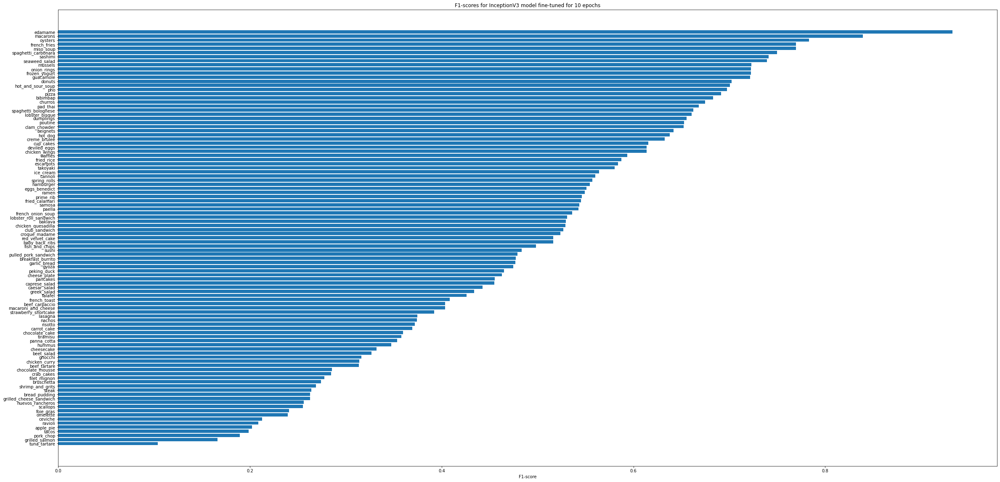

In [ ]:
# Create barh plot for model_1 f1-scores
fig, ax = plt.subplots(figsize=(40, 20))
scores_1 = ax.barh(range(len(model_1_loaded_f1_df)),
                   model_1_loaded_f1_df['f1-score'],
                   tick_label= model_1_loaded_f1_df['class_name'])
ax.set_xlabel('F1-score')
ax.set_title('F1-scores for InceptionV3 model fine-tuned for 10 epochs')
ax.invert_yaxis()
plt.show()

## Second interation of training


*   Create new preprocessing data augmentation layer with increased tweaking
*   Add `Dropout(.3)` layer after `GlobalAveragePooling2D()`



### Create and compile model_0_1: EfficentNetB0 with stronger regularization

In [ ]:
# Create new data augmentation
data_augmentation_B = Sequential([
    Input(shape=(224, 224, 3)),
    layers.RandomFlip('horizontal_and_vertical'),
    layers.RandomRotation(.5),
    layers.RandomHeight(.5),
    layers.RandomWidth(.5),
    layers.RandomZoom(.5),
    # layers.Rescaling(1./255) Required for models like ResNet50
], name='data_augmentation_B')

In [ ]:
# Create model 0_1 (EfficientNetB0)
inputs = Input(shape=(224, 224, 3), name='input layer')
x = data_augmentation_B(inputs)
x = base_model(x, training = False)
x = layers.GlobalAveragePooling2D(name='global_avf_pool1d_lay')(x)
x = tf.keras.layers.GaussianNoise(stddev=1, seed=123)(x)
x = tf.keras.layers.Dropout(.3)(x)
outputs = layers.Dense(len(train_data_10_percent.class_names), activation='softmax', name='output_layer')(x)
model_0_1 = tf.keras.Model(inputs, outputs)

In [ ]:
# Compile the model
model_0_1.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
                optimizer=tf.keras.optimizers.Adam(),
                metrics=['accuracy'])

### Create and compile model_1_1: InceptionV3 with stronger regularization

In [ ]:
# Create a model 1_1 (InceptionV3)
inputs_1_1 = Input(shape=(224, 224, 3), name='input_layer_1')
y = data_augmentation_B(inputs_1_1)
y = tf.cast(y, tf.float32)
y = tf.keras.applications.inception_v3.preprocess_input(y)
y = base_model_1(y, training = False)
y = layers.GlobalAveragePooling2D(name='global_avf_pool1d_lay_1')(y)
y = tf.keras.layers.GaussianNoise(stddev=1, seed=123)(y)
y = tf.keras.layers.Dropout(.3)(y)
outputs_1_1 = layers.Dense(len(train_data_10_percent.class_names), kernel_regularizer=tf.keras.regularizers.l2(.0005), activation='softmax', name='output_layer_1')(y)
model_1_1 = tf.keras.Model(inputs_1_1, outputs_1_1)

In [ ]:
# Compile second model
model_1_1.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
                optimizer=tf.keras.optimizers.Adam(),
                metrics=['accuracy'])

### Pre-train frozen models

In [ ]:
# Fit the model
history_0_1_0 = model_0_1.fit(train_data_10_percent,
                          validation_data=test_data_10_percent,
                          epochs=2,
                          steps_per_epoch=len(train_data_10_percent),
                          validation_steps=int(.25*len(test_data_10_percent)),
                          callbacks=[checkpoint_callback])

Epoch 1/2
237/237 [==============================] - 132s 527ms/step - loss: 4.6120 - accuracy: 0.1266 - val_loss: 2.4228 - val_accuracy: 0.3579
Epoch 2/2
237/237 [==============================] - 98s 410ms/step - loss: 3.4264 - accuracy: 0.2639 - val_loss: 2.1833 - val_accuracy: 0.4340


In [ ]:
# Fit the second model
history_1_1_0 = model_1_1.fit(train_data_10_percent,
                          validation_data=test_data_10_percent,
                          epochs=2,
                          steps_per_epoch=len(train_data_10_percent),
                          validation_steps=int(.25*len(test_data_10_percent)),
                          callbacks=[checkpoint_callback_1])

Epoch 1/2
237/237 [==============================] - 250s 1s/step - loss: 5.7995 - accuracy: 0.0774 - val_loss: 3.1816 - val_accuracy: 0.2741
Epoch 2/2
237/237 [==============================] - 173s 724ms/step - loss: 4.8467 - accuracy: 0.1628 - val_loss: 2.8370 - val_accuracy: 0.3269


### Fine-tune model_0_1

In [ ]:
base_model.summary()

Model: "efficientnetb0"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 rescaling (Rescaling)          (None, None, None,   0           ['input_3[0][0]']                
                                3)                                                                
                                                                                                  
 normalization (Normalization)  (None, None, None,   7           ['rescaling[0][0]']              
                                3)                                                   

In [ ]:
# unfreeze all of the layers in base_model
base_model.trainable = True

# Refreeze every layer except the last 8 ( 4 x Conv2d among them)
for layer in base_model.layers[:-16]:
  layer.trainable = False

In [ ]:
# Recompile the model with reduced learning rate
model_0_1.compile(
    loss=tf.keras.losses.CategoricalCrossentropy(),
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
    metrics=['accuracy']
)

In [ ]:
for layer in model_0_1.layers:
  print(layer.name, layer.trainable)

input layer True
data_augmentation_B True
efficientnetb0 True
global_avf_pool1d_lay True
gaussian_noise True
dropout True
output_layer True


In [ ]:
# Check which layers are trainable in base_model
for layer_number, layer in enumerate(model_0_1.layers[2].layers):
  print(layer_number, layer.name, layer.trainable, layer.trainable_variables)

0 input_3 False []
1 rescaling False []
2 normalization False []
3 tf.math.truediv False []
4 stem_conv_pad False []
5 stem_conv False []
6 stem_bn False []
7 stem_activation False []
8 block1a_dwconv False []
9 block1a_bn False []
10 block1a_activation False []
11 block1a_se_squeeze False []
12 block1a_se_reshape False []
13 block1a_se_reduce False []
14 block1a_se_expand False []
15 block1a_se_excite False []
16 block1a_project_conv False []
17 block1a_project_bn False []
18 block2a_expand_conv False []
19 block2a_expand_bn False []
20 block2a_expand_activation False []
21 block2a_dwconv_pad False []
22 block2a_dwconv False []
23 block2a_bn False []
24 block2a_activation False []
25 block2a_se_squeeze False []
26 block2a_se_reshape False []
27 block2a_se_reduce False []
28 block2a_se_expand False []
29 block2a_se_excite False []
30 block2a_project_conv False []
31 block2a_project_bn False []
32 block2b_expand_conv False []
33 block2b_expand_bn False []
34 block2b_expand_activation Fa

In [ ]:
# Fine-tune for 5 more epochs
fine_tune_epochs_1 = 30

# Fine-tune model_0_1
history_0_1_1 = model_0_1.fit(
    train_data_10_percent,
    epochs=fine_tune_epochs_1,
    validation_data=test_data_10_percent,
    validation_steps=int(.15*len(test_data_10_percent)),
    initial_epoch=history_0_1_0.epoch[-1]
)

Epoch 2/30
237/237 [==============================] - 99s 391ms/step - loss: 2.8155 - accuracy: 0.3640 - val_loss: 1.9058 - val_accuracy: 0.5273
Epoch 3/30
237/237 [==============================] - 84s 350ms/step - loss: 2.6821 - accuracy: 0.3900 - val_loss: 1.8114 - val_accuracy: 0.5448
Epoch 4/30
237/237 [==============================] - 83s 347ms/step - loss: 2.5612 - accuracy: 0.4074 - val_loss: 1.7795 - val_accuracy: 0.5482
Epoch 5/30
237/237 [==============================] - 79s 334ms/step - loss: 2.5086 - accuracy: 0.4170 - val_loss: 1.8339 - val_accuracy: 0.5387
Epoch 6/30
237/237 [==============================] - 76s 322ms/step - loss: 2.4314 - accuracy: 0.4370 - val_loss: 1.8238 - val_accuracy: 0.5352
Epoch 7/30
237/237 [==============================] - 74s 311ms/step - loss: 2.3186 - accuracy: 0.4569 - val_loss: 1.7902 - val_accuracy: 0.5548
Epoch 8/30
237/237 [==============================] - 72s 303ms/step - loss: 2.2953 - accuracy: 0.4562 - val_loss: 1.8280 - val_ac

In [ ]:
# Evaluate on the whole test_data
model_0_1.evaluate(test_data_10_percent)

790/790 [==============================] - 57s 72ms/step - loss: 1.5969 - accuracy: 0.6185


[1.5968561172485352, 0.6184950470924377]

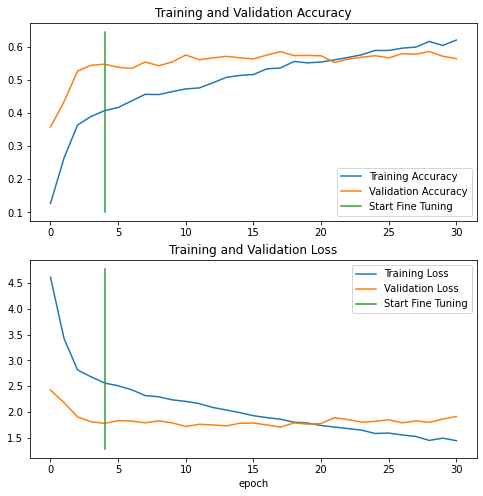

In [ ]:
# Compate the histories of feature-extraction model with 1. fine-tuning model
compare_historys(history_0_1_0, history_0_1_1)

In [ ]:
model_0_1.save('drive/MyDrive/Colab Notebooks/06_tansfer_learning_scaling_up_FILES/model_0_1.h5')

### Fine-tune model_1_1

In [ ]:
base_model_1.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   864         ['input_4[0][0]']                
                                32)                                                               
                                                                                                  
 batch_normalization (BatchNorm  (None, None, None,   96         ['conv2d[0][0]']                 
 alization)                     32)                                                    

In [ ]:
# unfreeze all of the layers in base_model_1
base_model_1.trainable = True

# Refreeze every layer except the last 8 ( 4 x Conv2d among them)
for layer in base_model_1.layers[:-22]:
  layer.trainable = False

In [ ]:
# Recompile the model with reduced learning rate
model_1_1.compile(
    loss=tf.keras.losses.CategoricalCrossentropy(),
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
    metrics=['accuracy']
)

In [ ]:
# Fine-tune for 5 more epochs
fine_tune_epochs_1 = 30

# Fine-tune model_0
history_1_1_1 = model_1_1.fit(
    train_data_10_percent,
    epochs=fine_tune_epochs_1,
    validation_data=test_data_10_percent,
    validation_steps=int(.15*len(test_data_10_percent)),
    initial_epoch=history_1_1_0.epoch[-1]
)

Epoch 2/30
237/237 [==============================] - 161s 651ms/step - loss: 4.1399 - accuracy: 0.2144 - val_loss: 2.6473 - val_accuracy: 0.3644
Epoch 3/30
237/237 [==============================] - 142s 599ms/step - loss: 3.8815 - accuracy: 0.2384 - val_loss: 2.6410 - val_accuracy: 0.3766
Epoch 4/30
237/237 [==============================] - 137s 574ms/step - loss: 3.7367 - accuracy: 0.2552 - val_loss: 2.6644 - val_accuracy: 0.3633
Epoch 5/30
237/237 [==============================] - 122s 510ms/step - loss: 3.6532 - accuracy: 0.2519 - val_loss: 2.6312 - val_accuracy: 0.3676
Epoch 6/30
237/237 [==============================] - 115s 487ms/step - loss: 3.5437 - accuracy: 0.2729 - val_loss: 2.5254 - val_accuracy: 0.3967
Epoch 7/30
237/237 [==============================] - 117s 491ms/step - loss: 3.4622 - accuracy: 0.2788 - val_loss: 2.4568 - val_accuracy: 0.4100
Epoch 8/30
237/237 [==============================] - 118s 496ms/step - loss: 3.4609 - accuracy: 0.2883 - val_loss: 2.4026 -

In [ ]:
model_1_1.evaluate(test_data_10_percent)

790/790 [==============================] - 63s 80ms/step - loss: 1.9120 - accuracy: 0.5249


[1.9119735956192017, 0.5249108672142029]

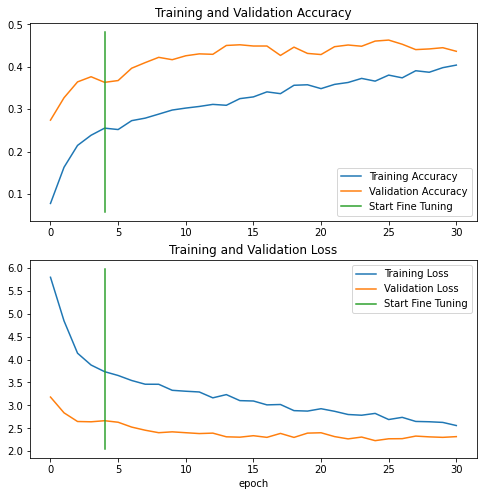

In [ ]:
compare_historys(history_1_1_0, history_1_1_1)

In [ ]:
model_1_1.save('drive/MyDrive/Colab Notebooks/06_tansfer_learning_scaling_up_FILES/model_1_1.h5')

## Making predictions on test images

A. Create a function that will:
1. Read a target image from filepath using `tf.io.read_file()`
2. Turn the imahe into a tensor using `tf.io.decode_image()`
3. Resize the image tensor to the same size as the images digested by the model using `tf.image.resize()`
4. Scale the pixel values to the range between 0 and 1.

B. Create function that will visualize and label images, using a given model.
1. Load a batch of random images from the test dataset
2. Make predictions on the loaded images
3. Plot the original image with the model's prediction, predictiob probability and truth label.

In [ ]:
# Create the function

def load_and_prep(filename, img_shape=224, scale=True):
  '''
  Reads an image from filename, turns it into a tensor, reshapes it
  to specified shape.

  Args: 
    filename (str): path to target image
    image_shape (int): height / width dimension of target image size
    scale (bool): scale pixel values from <0-255> to <0-1>
  '''
  # Read a file 
  img = tf.io.read_file(filename)

  # Decode image into tensor
  img = tf.io.decode_image(img, channels=3)

  # Resize the image
  img = tf.image.resize(img, [img_shape, img_shape])

  # Scale? Y/N
  if scale:
    # rescale the image (to values between 0 and 1)
    return img/255.
  else:
    return img

In [ ]:
# Load necessary modules
import tensorflow as tf
import os
import random


In [ ]:
# Load saved models
model_0_1_loaded = tf.keras.models.load_model('drive/MyDrive/Colab Notebooks/06_tansfer_learning_scaling_up_FILES/model_0_1.h5')

In [ ]:
model_1_1_loaded = tf.keras.models.load_model('drive/MyDrive/Colab Notebooks/06_tansfer_learning_scaling_up_FILES/model_1_1.h5')

In [ ]:
def pred_and_vis(dir=test_dir, class_names=class_names, model=model_0_1_loaded, n_samples=3):
  plt.figure(figsize=(10, int(10*n_samples)))
  for i in range(n_samples):
    # Choose a random image from random class name
    class_name = random.choice(class_names)
    filename = random.choice(os.listdir(dir + '/' + class_name))
    filepath = dir + '/' + class_name + '/' + filename

    # Load the image and make predictions
    img = load_and_prep(filepath, scale=False)
    pred_prob = model.predict(tf.expand_dims(img, axis=0), verbose=0) # Expand dimensions due to model's input shape
    pred_class = class_names[pred_prob.argmax()]
    
    # Create a subplot, show image and annotate it
    plt.subplot(n_samples, 1, i+1)
    plt.imshow(img/255.)
    if class_name == pred_class:
      title_color= 'g'
    else:
      title_color= 'r'
    plt.title(f'actual: {class_name}, pred: {pred_class}, prob: {pred_prob.max():.2f}', c=title_color)
    plt.axis(False)


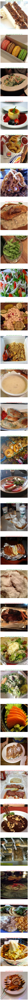

In [ ]:
pred_and_vis(n_samples=30)

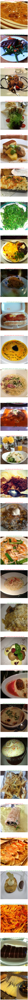

In [ ]:
pred_and_vis(model=model_1_1, n_samples=30)

## Finding most wrong predictions
A good way to inspect your model's predictions is to view the wrong predictions with the highest prediction probability (or highest loss)

This can lead to unfolding:
*   Data issues (wrong labels)
*   Confusing classes

To find out where our model's are most wrong we will:
1. Get all of the image filepaths in the test dataset using `list_files()` method
2. Create a pandas DataFrame of the image filepaths, true labels, predicted classes prediction probabilities, predicted class names and label class names.
3. Use our DataFrame to find all the wrong predictions.
4. Sort the DataFrame base on high prediction probability among wrongly predicted labels.
5. Visualize images sorted out this way.



In [ ]:
# Get all files' paths using list_files()
filepaths = []
for filepath in test_data_10_percent.list_files(
    '/content/101_food_classes_10_percent/test/*/*.jpg',
    shuffle=False
    ):
  filepaths.append(filepath.numpy())
filepaths[:10]


[b'/content/101_food_classes_10_percent/test/apple_pie/1011328.jpg',
 b'/content/101_food_classes_10_percent/test/apple_pie/101251.jpg',
 b'/content/101_food_classes_10_percent/test/apple_pie/1034399.jpg',
 b'/content/101_food_classes_10_percent/test/apple_pie/103801.jpg',
 b'/content/101_food_classes_10_percent/test/apple_pie/1038694.jpg',
 b'/content/101_food_classes_10_percent/test/apple_pie/1047447.jpg',
 b'/content/101_food_classes_10_percent/test/apple_pie/1068632.jpg',
 b'/content/101_food_classes_10_percent/test/apple_pie/110043.jpg',
 b'/content/101_food_classes_10_percent/test/apple_pie/1106961.jpg',
 b'/content/101_food_classes_10_percent/test/apple_pie/1113017.jpg']

In [ ]:
# Predict on the test data using model_0_1_loaded
pred_probs_0_1 = model_0_1_loaded.predict(test_data_10_percent)

790/790 [==============================] - 78s 88ms/step


In [ ]:
# Create an array with predicted classes for model_0_1_loaded
pred_classes_0_1 = pred_probs_0_1.argmax(axis=1)

In [ ]:
# Predict on the test data using model_1_1_loaded
pred_probs_1_1 = model_1_1_loaded.predict(test_data_10_percent)

790/790 [==============================] - 68s 83ms/step


In [ ]:
# Create an array with predicted classes for model_1_1_loaded
pred_classes_1_1 = pred_probs_1_1.argmax(axis=1)

In [ ]:
# Unbatch test data 
test_data_unbatched = test_data_10_percent.unbatch()

In [ ]:
# Create a list of true labels
import numpy as np
labels = np.array(list(test_data_unbatched.map(lambda x, y: y)))

In [ ]:
# Create a list of true labels
y_labels = labels.argmax(axis=1)
y_labels[:15]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
# Get class names
class_names = np.array(test_data_10_percent.class_names)

In [ ]:
# Create the data frame for model_0_1_loaded
pred_0_1_df = pd.DataFrame(
    {'img_path': filepaths,
    'y_true': y_labels,
    'y_pred': pred_classes_0_1,
    'pred_conf': pred_probs_0_1.max(axis=1),
    'y_true_class_name': [class_names[i] for i in y_labels],
    'y_pred_class_name': [class_names[i] for i in pred_classes_0_1],
     }
)

# Create the data frame for model_0_1_loaded
pred_1_1_df = pd.DataFrame({
    'img_path': filepaths,
    'y_true': y_labels,
    'y_pred': pred_classes_1_1,
    'pred_conf': pred_probs_1_1.max(axis=1),
    'y_true_class_name': [class_names[i] for i in y_labels],
    'y_pred_class_name': [class_names[i] for i in pred_classes_1_1],
    }
)

In [ ]:
# Add pred_correct columns
pred_0_1_df['pred_correct'] = pred_0_1_df['y_pred'] == pred_0_1_df['y_true']
pred_1_1_df['pred_correct'] = pred_1_1_df['y_pred'] == pred_1_1_df['y_true']

In [ ]:
import matplotlib.pyplot as plt


#### Create the list of shame for EfficientNetB0

In [58]:
the_list = pred_0_1_df.sort_values(by=['pred_correct', 'pred_conf'], ascending=[True, False]).iloc[:20]

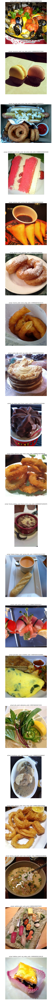

In [62]:
plt.figure(figsize=(10, int(10*20)))
for i, row in enumerate(the_list.index):
  # Load the file path
  path = the_list.loc[row,"img_path"]
  path = path.decode('utf-8')
  
  # Load the file 
  img = plt.imread(path)
    
  # Create a subplot, show image and annotate it
  plt.subplot(20, 1, i+1)
  plt.imshow(img/255.)
  plt.title(f'actual: {the_list.loc[row, "y_true_class_name"]}, pred: {the_list.loc[row, "y_pred_class_name"]}, prob: {the_list.loc[row, "pred_conf"]}')
  plt.axis(False)


#### Create the list of shame for InceptionV3

In [60]:
# Create the list with 20 worse predictions
the_list_1 = pred_1_1_df.sort_values(by=['pred_correct', 'pred_conf'], ascending=[True, False]).iloc[:20]

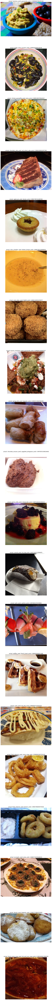

In [63]:
plt.figure(figsize=(10, int(10*20)))
for i, row in enumerate(the_list_1.index):
  # Load the file path
  path = the_list_1.loc[row,"img_path"]
  path = path.decode('utf-8')
  
  # Load the file 
  img = plt.imread(path)
    
  # Create a subplot, show image and annotate it
  plt.subplot(20, 1, i+1)
  plt.imshow(img/255.)
  plt.title(f'actual: {the_list_1.loc[row, "y_true_class_name"]}, pred: {the_list_1.loc[row, "y_pred_class_name"]}, prob: {the_list_1.loc[row, "pred_conf"]}')
  plt.axis(False)